# Enhancing E-Commerce Strategies Through Customer Behavior Analysis
<span style="font-size:20px;">\- Amisha Kelkar, Arundhati(Ari) Kolahal, Chaitali Deshmukh, Neha Shastri

## Data Cleaning and Preparation

### Importing relevant libraries

In [1]:
import pandas as pd 
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from joblib import Parallel, delayed
!pip install mlxtend
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
from mlxtend.preprocessing import TransactionEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
!pip install psynlig
from matplotlib import pyplot as plt
from psynlig import (pca_explained_variance, pca_explained_variance_bar)
import plotly.express as px
import plotly.graph_objects as go
from sklearn.cluster import KMeans


### Loading the Dataset

In [2]:
events = pd.read_csv('events.csv')
events.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2756101 entries, 0 to 2756100
Data columns (total 5 columns):
 #   Column         Non-Null Count    Dtype  
---  ------         --------------    -----  
 0   timestamp      2756101 non-null  int64  
 1   visitorid      2756101 non-null  int64  
 2   event          2756101 non-null  object 
 3   itemid         2756101 non-null  int64  
 4   transactionid  22457 non-null    float64
dtypes: float64(1), int64(3), object(1)
memory usage: 105.1+ MB


### Preprocessing Data and Feature Engineering

* The `timestamp` column in the events is converted to datetime from timestamp. 
* The number of events have been aggregated per user
* The number of unique items purchased by every visitor is counted.

In [3]:

# Convert timestamp to datetime
events['timestamp'] = pd.to_datetime(events['timestamp'], unit='ms')

# Aggregate counts per visitor
event_counts = events.pivot_table(index='visitorid', columns='event', values='itemid', aggfunc='count', fill_value=0)
event_counts.columns = ['total_addtocart', 'total_transaction', 'total_view']

# Count unique items per visitor
unique_items = events.groupby('visitorid')['itemid'].nunique().reset_index(name='unique_items')

* The `compute_avg_time_diffs` computes time differnece in seconds between each of the event i.e. view, add_to_cart and transactions
* The `compute_avg_transaction_gap`  computes average time between transactions
* The `process_visitor_batch` processes the data in batches to run the above functions in order to compute the features calculaed in previous functions
* Since the `events` data is large, using the defined functions, the data is processed in batches of 10,000 visitors and results are concatenated to a final dataframe `final_df` which is saved in parquet format for future use. The parquet file was used subsequently due to computational complexity.

In [ ]:
# Function to compute time differences for event pairs
def compute_avg_time_diffs(ordered_events, event1, event2):
    timestamps_1 = ordered_events.loc[ordered_events['event'] == event1, 'timestamp'].values
    timestamps_2 = ordered_events.loc[ordered_events['event'] == event2, 'timestamp'].values
    
    # Match each event1 to the next occurring event2
    time_diffs = []
    i, j = 0, 0
    while i < len(timestamps_1) and j < len(timestamps_2):
        if timestamps_2[j] > timestamps_1[i]: 
            time_diffs.append(timestamps_2[j] - timestamps_1[i])
            i += 1
        j += 1  

    time_diffs = np.array(time_diffs) / 1e9  
    return np.mean(time_diffs) if len(time_diffs) > 0 else np.nan

# Function to compute time between transactions
def compute_avg_transaction_gap(ordered_transactions):
    if len(ordered_transactions) < 2:
        return np.nan

    time_diffs = np.diff(ordered_transactions) / 1e9  # Convert to seconds
    return np.mean(time_diffs) if len(time_diffs) > 0 else np.nan

# Process a batch of visitors
def process_visitor_batch(batch_id, visitor_ids):
    batch_results = []

    for visitor_id in visitor_ids:
        visitor_data = df[df['visitorid'] == visitor_id].sort_values(by='timestamp')  # To ensure correct event order
        
        avg_view_to_addcart = compute_avg_time_diffs(visitor_data, 'view', 'addtocart')
        avg_addcart_to_transaction = compute_avg_time_diffs(visitor_data, 'addtocart', 'transaction')

        transaction_times = visitor_data.loc[visitor_data['event'] == 'transaction', 'timestamp'].values
        avg_transaction_gap = compute_avg_transaction_gap(transaction_times)

        batch_results.append({
            'visitorid': visitor_id,
            'avg_time_view_to_addtocart': avg_view_to_addcart,
            'avg_time_addtocart_to_transaction': avg_addcart_to_transaction,
            'avg_time_between_transactions': avg_transaction_gap
        })

    # Save batch results as Parquet
    batch_filename = f'batch_results_{batch_id}.parquet'
    pd.DataFrame(batch_results).to_parquet(batch_filename)
    return batch_filename

# Load DataFrame and ensure timestamps are sorted
df = events.sort_values(by=['visitorid', 'timestamp'])  # Sort entire dataset once

# Split visitors into chunks
visitor_ids = df['visitorid'].unique()
chunk_size = 10_000
visitor_chunks = [visitor_ids[i:i + chunk_size] for i in range(0, len(visitor_ids), chunk_size)]

# Parallel processing
batch_files = Parallel(n_jobs=-1)(
    delayed(process_visitor_batch)(i, chunk) for i, chunk in enumerate(visitor_chunks)
)

# Combine all results
final_df = pd.concat([pd.read_parquet(file) for file in batch_files])

# Save final results
final_df.to_parquet("final_visitor_metrics.parquet")

print("Processing complete. Results saved in 'final_visitor_metrics.parquet'.")


In [4]:
final_df = pd.read_parquet("final_visitor_metrics.parquet")

* The week is extracted from the timestamp in the `events` dataset.
* The average interactions per user in a week been calculated.
* The average items per transaction for every user in a week has been calculated.

In [5]:
#USE THIS

# Compute frequency of interactions in a week
events['week'] = events['timestamp'].dt.to_period('W')

interaction_stats = (
    events.groupby('visitorid')
    .agg(total_interactions=('week', 'count'), unique_weeks=('week', 'nunique'))
    .assign(avg_interactions_per_week=lambda x: x['total_interactions'] / x['unique_weeks'])
    .reset_index()
)

# Average number of items per transaction
avg_items_per_transaction = events[events['event'] == 'transaction'].groupby('visitorid')['transactionid'].count().reset_index()
avg_items_per_transaction = avg_items_per_transaction.groupby('visitorid')['transactionid'].mean().reset_index(name='avg_items_per_transaction')

In [6]:
interaction_stats.head(3)

,visitorid,total_interactions,unique_weeks,avg_interactions_per_week
0,0,3,1,3.0
1,1,1,1,1.0
2,2,8,1,8.0


* In order to get more insight in the customer behaviour patterns, conditional probability of events have been calculated.
* The conditional probability of a user adding an item to the cart when an item was viewed has been calculated.
* The conditional probability of a user actually getting through with the transaction when an item has been added to cart has been calculated.

In [6]:
conditional_probs = events.groupby(['visitorid', 'itemid', 'event']).size().unstack(fill_value=0)

# Compute conditional probabilities
conditional_probs['p_addtocart_given_view'] = conditional_probs['addtocart'] / conditional_probs['view'].replace(0, 1)
conditional_probs['p_transaction_given_addtocart'] = conditional_probs['transaction'] / conditional_probs['addtocart'].replace(0, 1)
conditional_probs = conditional_probs.groupby('visitorid')[['p_addtocart_given_view', 'p_transaction_given_addtocart']].mean()

Probabilty should not be greater than 1. Therefore we are capping it at 1. 

In [8]:
# Filter rows where p_addtocart_given_view > 1
invalid_entries = conditional_probs[conditional_probs['p_addtocart_given_view'] > 1].reset_index()

# Display the first 3 rows
invalid_entries.head(3)

event,visitorid,itemid,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart
0,745,246164,2,0,1,2.0,0.0
1,918,222888,2,0,0,2.0,0.0
2,1399,136523,2,0,0,2.0,0.0


In [9]:
invalid_entries = conditional_probs[conditional_probs['p_transaction_given_addtocart'] > 1].reset_index()

# Display the first 3 rows
invalid_entries.head(3)

event,visitorid,itemid,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart
0,11248,409804,1,2,2,0.500000,2.0
1,29802,393809,1,2,2,0.500000,2.0
2,30374,107503,1,2,3,0.333333,2.0


In [7]:
# Cap probabilities at 1
conditional_probs['p_addtocart_given_view'] = conditional_probs['p_addtocart_given_view'].clip(upper=1)
conditional_probs['p_transaction_given_addtocart'] = conditional_probs['p_transaction_given_addtocart'].clip(upper=1)

* Combined all the features extracted from `events` to create a new dataframe `users` which has data at a user level instead of transaction-level as was the case previously in the `events` dataframe.
* Replaces the nulls to 0 and converted the `users` to parquet for subsequent use.

In [9]:
# Merge all computed features
users = event_counts.merge(unique_items, on='visitorid', how='left')\
                        .merge(final_df, on='visitorid', how='left')\
                        .merge(interaction_stats[['avg_interactions_per_week', 'visitorid']], on='visitorid', how='left')\
                        .merge(conditional_probs, on='visitorid', how='left')\
                        .merge(avg_items_per_transaction, on='visitorid', how='left')

users.to_parquet('users.parquet')
# Display the final DataFrame
print(users.head())

   visitorid  total_addtocart  total_transaction  total_view  unique_items  \
0          0                0                  0           3             3   
1          1                0                  0           1             1   
2          2                0                  0           8             4   
3          3                0                  0           1             1   
4          4                0                  0           1             1   

   avg_time_view_to_addtocart  avg_time_addtocart_to_transaction  \
0                         NaN                                NaN   
1                         NaN                                NaN   
2                         NaN                                NaN   
3                         NaN                                NaN   
4                         NaN                                NaN   

   avg_time_between_transactions  avg_interactions_per_week  \
0                            NaN                        3.0

In [13]:
users.head(3)

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_time_view_to_addtocart,avg_time_addtocart_to_transaction,avg_time_between_transactions,avg_interactions_per_week,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart,avg_items_per_transaction
0,0,0,0,3,3,NaN,NaN,NaN,3.0,0,0,1,0.0,0.0,NaN
1,0,0,0,3,3,NaN,NaN,NaN,3.0,0,0,1,0.0,0.0,NaN
2,0,0,0,3,3,NaN,NaN,NaN,3.0,0,0,1,0.0,0.0,NaN


In [14]:
missing_values = users.isnull().sum()
print("Missing Values Summary:")
print(missing_values[missing_values > 0])

Missing Values Summary:
avg_time_view_to_addtocart           1943703
avg_time_addtocart_to_transaction    2036793
avg_time_between_transactions        2063633
avg_items_per_transaction            2033400
dtype: int64


In [10]:
users.fillna(0, inplace=True)

In [13]:
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1407580 entries, 0 to 1407579
Data columns (total 12 columns):
 #   Column                             Non-Null Count    Dtype  
---  ------                             --------------    -----  
 0   visitorid                          1407580 non-null  int64  
 1   total_addtocart                    1407580 non-null  int64  
 2   total_transaction                  1407580 non-null  int64  
 3   total_view                         1407580 non-null  int64  
 4   unique_items                       1407580 non-null  int64  
 5   avg_time_view_to_addtocart         1407580 non-null  float64
 6   avg_time_addtocart_to_transaction  1407580 non-null  float64
 7   avg_time_between_transactions      1407580 non-null  float64
 8   avg_interactions_per_week          1407580 non-null  float64
 9   p_addtocart_given_view             1407580 non-null  float64
 10  p_transaction_given_addtocart      1407580 non-null  float64
 11  avg_items_per_transactio

In [12]:
users.to_parquet('users.parquet')

# Anomoly Detection

## PCA

In [2]:
users = pd.read_parquet('users.parquet')

In [23]:
users.set_index('visitorid', inplace=True)
users.head(3)

,total_addtocart,total_transaction,total_view,unique_items,avg_time_view_to_addtocart,avg_time_addtocart_to_transaction,avg_time_between_transactions,avg_interactions_per_week,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart,avg_items_per_transaction
visitorid,,,,,,,,,,,,,,
0,0,0,3,3,0.0,0.0,0.0,3.0,0,0,1,0.0,0.0,0.0
0,0,0,3,3,0.0,0.0,0.0,3.0,0,0,1,0.0,0.0,0.0
0,0,0,3,3,0.0,0.0,0.0,3.0,0,0,1,0.0,0.0,0.0


In [64]:

sc = StandardScaler()
normalized_users = sc.fit_transform(users)
normalized_users_df = pd.DataFrame(normalized_users, columns=users.columns.tolist())

In [65]:


# Create the model
model = PCA()

#fit the data
model.fit(normalized_users)

# transform the data
transformed_users = model.transform(normalized_users)
transformed_users_df = pd.DataFrame(transformed_users)

# Rename the columns
transformed_users_df.columns = [f"PC{i+1}" for i in range(users.shape[1])]

transformed_users_df.head(3)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14
0,-0.387539,-0.211105,-0.093356,-0.060469,-0.183208,0.011973,-0.051519,-0.042031,0.024328,0.000473,0.001081,-0.001003,0.000561,6.403129e-17
1,-0.387539,-0.211105,-0.093356,-0.060469,-0.183208,0.011973,-0.051519,-0.042031,0.024328,0.000473,0.001081,-0.001003,0.000561,6.403129e-17
2,-0.387539,-0.211105,-0.093356,-0.060469,-0.183208,0.011973,-0.051519,-0.042031,0.024328,0.000473,0.001081,-0.001003,0.000561,6.403129e-17


In [66]:

model.explained_variance_

array([5.82258544e+00, 2.69387275e+00, 1.52473155e+00, 1.05218079e+00,
       9.54676002e-01, 6.28094703e-01, 5.49918276e-01, 4.07101941e-01,
       1.70530686e-01, 1.42326466e-01, 4.17795227e-02, 8.77757999e-03,
       3.43081575e-03, 5.44987775e-16])

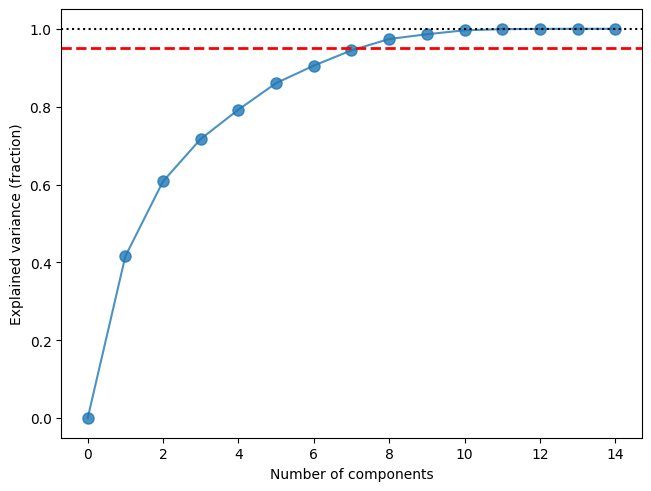

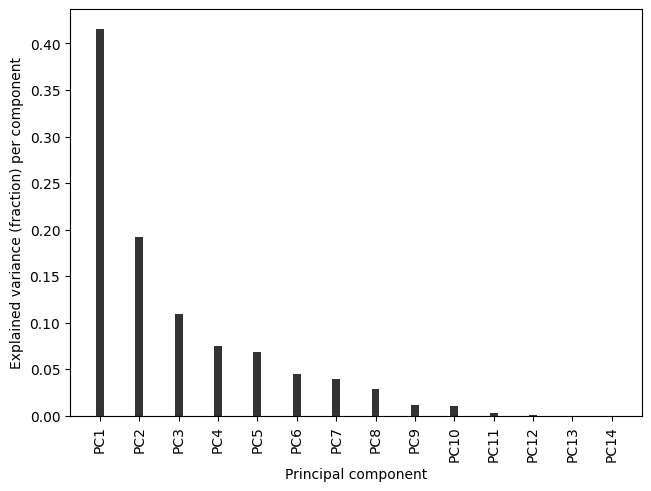

In [76]:

_, ax = pca_explained_variance(model,  marker='o', markersize=8, alpha=0.8)

# Let's add a line at an explained variance of 90%
ax.axhline(y=0.95, color='r', linestyle='--', linewidth=2)

plt.show()

pca_explained_variance_bar(
    model,
    width=0.2,
    alpha=0.8,
    color='black',
)

plt.show()

In [67]:

transformed_users_df.describe()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14
count,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06
mean,6.460265e-17,-5.999196e-17,3.815743e-18,-3.084392e-17,-2.358341e-17,-1.132799e-17,-5.776611e-17,-4.642488e-17,-2.376228e-17,-1.253366e-17,-1.528616e-18,-6.350298e-17,1.076159e-17,7.561646e-18
std,2.413003e+00,1.641302e+00,1.234800e+00,1.025759e+00,9.770752e-01,7.925243e-01,7.415647e-01,6.380454e-01,4.129536e-01,3.772618e-01,2.044004e-01,9.368874e-02,5.857317e-02,4.542851e-15
min,-4.055805e-01,-8.087405e+00,-1.144424e+01,-5.625673e+01,-3.488848e+01,-2.254886e+01,-2.401789e+01,-6.196273e+00,-2.737687e+01,-4.614771e+00,-2.024511e+01,-1.924586e+00,-1.315831e+00,-1.690576e-13
25%,-4.055805e-01,-2.099929e-01,-9.156465e-02,-6.104702e-02,-1.837875e-01,9.985953e-03,-5.839153e-02,-7.478939e-02,2.389049e-02,1.886011e-03,8.899848e-04,-1.148129e-03,5.611015e-04,6.403129e-17
50%,-3.985391e-01,-2.083200e-01,-8.977365e-02,-6.104702e-02,-1.837409e-01,9.985953e-03,-5.839153e-02,-7.478939e-02,2.389049e-02,3.298688e-03,8.899848e-04,-7.929974e-04,1.464764e-03,9.178686e-17
75%,-3.692249e-01,-2.083200e-01,-8.977365e-02,-6.017993e-02,-1.820885e-01,1.332277e-02,-5.208546e-02,-4.686432e-02,2.418256e-02,3.298688e-03,1.300751e-03,-7.929974e-04,1.464764e-03,9.178686e-17
max,4.598529e+01,7.453036e+01,6.203549e+01,1.674896e+02,1.995955e+02,6.801901e+01,1.210096e+01,1.081499e+01,9.790939e+01,5.188351e+00,8.341222e+01,3.613872e+00,1.295613e+00,9.924352e-14


In [68]:
components_df = pd.DataFrame(model.components_, index=[f'PC{i+1}' for i in range(len(model.components_))], columns=normalized_users_df.columns.tolist())

components_df['magnitude'] = components_df.apply(lambda row: np.sqrt(np.sum(row**2)), axis=1)

components_df.head(3)

,total_addtocart,total_transaction,total_view,unique_items,avg_time_view_to_addtocart,avg_time_addtocart_to_transaction,avg_time_between_transactions,avg_interactions_per_week,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart,avg_items_per_transaction,magnitude
PC1,0.395177,0.392710,0.399347,0.396444,0.217088,0.162271,0.053562,0.333027,0.075560,0.099569,0.025305,0.071862,0.100420,0.392710,1.0
PC2,-0.073826,-0.079423,-0.092346,-0.089689,0.001206,0.014748,0.040295,-0.040022,0.485161,0.505715,0.081166,0.464246,0.498674,-0.079423,1.0
PC3,-0.120474,-0.146254,-0.032454,-0.022568,0.477602,0.553214,0.624789,-0.086494,-0.014230,-0.057620,0.036476,-0.023511,-0.061207,-0.146254,1.0


In [69]:
loadings = components_df.drop('magnitude', axis=1).mul(np.sqrt(model.explained_variance_), axis=0)

loadings_df = pd.DataFrame(loadings, index=[f'PC{i+1}' for i in range(len(model.components_))], columns=normalized_users_df.columns.tolist())


In [70]:
loadings_df.head(3)

,total_addtocart,total_transaction,total_view,unique_items,avg_time_view_to_addtocart,avg_time_addtocart_to_transaction,avg_time_between_transactions,avg_interactions_per_week,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart,avg_items_per_transaction
PC1,0.953562,0.947611,0.963626,0.956622,0.523833,0.391560,0.129245,0.803595,0.182326,0.240260,0.061061,0.173403,0.242315,0.947611
PC2,-0.121170,-0.130358,-0.151568,-0.147206,0.001980,0.024206,0.066136,-0.065688,0.796296,0.830031,0.133217,0.761969,0.818475,-0.130358
PC3,-0.148761,-0.180595,-0.040075,-0.027866,0.589742,0.683108,0.771489,-0.106802,-0.017571,-0.071149,0.045041,-0.029031,-0.075578,-0.180595


In [71]:


# Apply PCA with 5 components
pca_7 = PCA(n_components=7)
transformed_users_7pc = pca_7.fit_transform(normalized_users)

# Reconstruct data
reconstructed_data = pca_7.inverse_transform(transformed_users_7pc)

# Compute Reconstruction Error (Euclidean distance)
reconstruction_error = np.linalg.norm(normalized_users - reconstructed_data, axis=1)

# Compute Mean and Standard Deviation
mean_error = np.mean(reconstruction_error)
std_error = np.std(reconstruction_error)

# Identify Outliers (Error > 3 Standard Deviations)
threshold = mean_error + 3 * std_error

# Convert transformed data back to DataFrame
transformed_users_7pc = pd.DataFrame(transformed_users_7pc, columns=[f'PC{i+1}' for i in range(7)])
transformed_users_7pc['pca_outlier'] = (reconstruction_error > threshold).astype(int)
# Copy the 'pca_outlier' column from transformed_users_5pc to transformed_users_df
transformed_users_df['pca_outlier'] = transformed_users_7pc['pca_outlier']



In [92]:
#Need to take a sample because plotly taking too much time
transformed_users_df_sampled = transformed_users_df.sample(n=100000, random_state=142)  # Adjust the number as needed

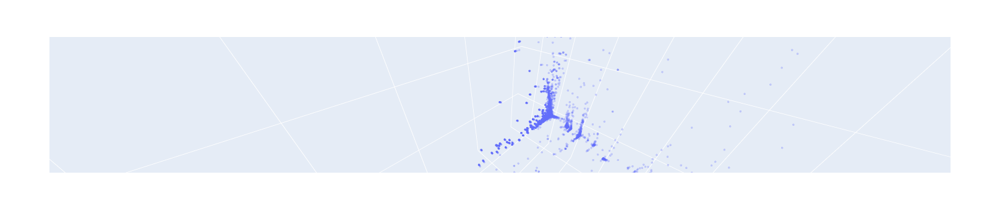

In [93]:

transformed_users_df = transformed_users_df.astype('float32')


# Create a 3D scatter plot
fig = px.scatter_3d( #scatter_3d scatter
    transformed_users_df_sampled,
    x="PC1",  # First principal component
    y="PC2",  # Second principal component
    z="PC3",  # Third principal component
)

fig.update_traces(
    marker=dict(
        size=2,  # Smaller marker size
        opacity=0.3  # Transparency (alpha)
    )
)

# Show the plot
fig.show()

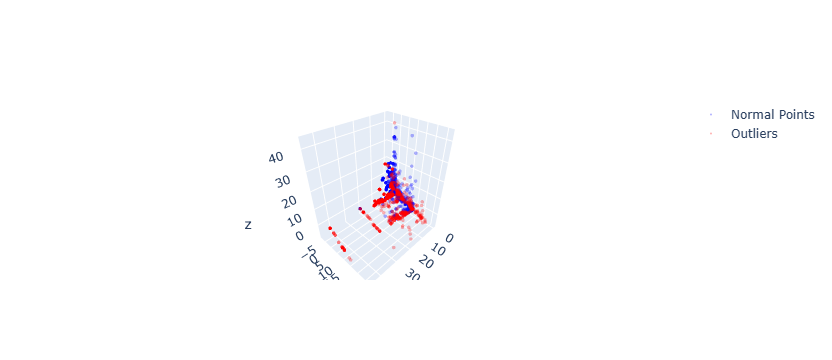

In [94]:


# Separate outliers in the sampled data
sampled_outliers = transformed_users_df_sampled[transformed_users_df_sampled["pca_outlier"] == 1]
sampled_normal_data = transformed_users_df_sampled[transformed_users_df_sampled["pca_outlier"] == 0]

# Create a 3D scatter plot
fig = go.Figure()

# Add normal points (blue)
fig.add_trace(
    go.Scatter3d(
        x=sampled_normal_data["PC1"],
        y=sampled_normal_data["PC2"],
        z=sampled_normal_data["PC3"],
        mode="markers",
        marker=dict(size=2, opacity=0.3, color="blue"),
        name="Normal Points",
    )
)

# Add outliers (red)
fig.add_trace(
    go.Scatter3d(
        x=sampled_outliers["PC1"],
        y=sampled_outliers["PC2"],
        z=sampled_outliers["PC3"],
        mode="markers",
        marker=dict(size=2, opacity=0.3, color="red"),
        name="Outliers",
    )
)

# Show the plot
fig.show()


In [95]:
pca_outliers = transformed_users_df[transformed_users_df["pca_outlier"] == 1]

In [96]:
pca_outliers.shape[0]

44801

In [97]:
pca_outliers.describe()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,pca_outlier
count,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,4.480100e+04,44801.0
mean,10.521233,0.681460,0.273089,0.149541,0.456831,-0.461637,1.226241,1.685215,0.320552,-0.057798,0.146098,-0.004947,-0.030421,-2.980238e-16,1.0
std,10.585010,6.281425,4.501762,3.752673,4.079376,2.871795,3.922164,3.735649,2.232985,2.296430,1.301902,0.532946,0.335938,2.630495e-14,0.0
min,0.324149,-8.087405,-11.444238,-56.256729,-34.888477,-22.548857,-24.017893,-6.196272,-27.376873,-4.614771,-20.245110,-1.924586,-1.315831,-1.690576e-13,1.0
25%,3.409853,-2.076622,-1.632115,-0.305985,-0.096268,-0.924276,-0.458529,-0.973069,-0.049463,-1.761306,0.013147,-0.228930,-0.238097,-8.641798e-15,1.0
50%,7.745003,-1.159274,-0.524947,-0.100963,-0.018795,0.225075,0.828935,1.943548,0.079969,-0.250685,0.025572,0.001691,0.045313,-2.507445e-16,1.0
75%,11.997291,-0.203507,0.996253,0.327589,0.571642,0.882549,2.174681,4.096130,0.167531,1.184747,0.038112,0.141341,0.233625,5.410222e-15,1.0
max,45.985294,74.530357,62.035492,167.489639,199.595505,67.634117,12.100963,10.814988,97.909393,5.188352,83.412224,3.613872,0.884914,9.924352e-14,1.0


# Customer Segmentation

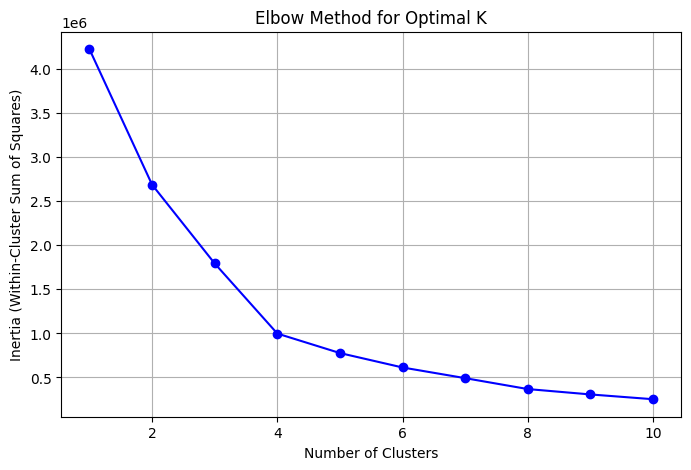

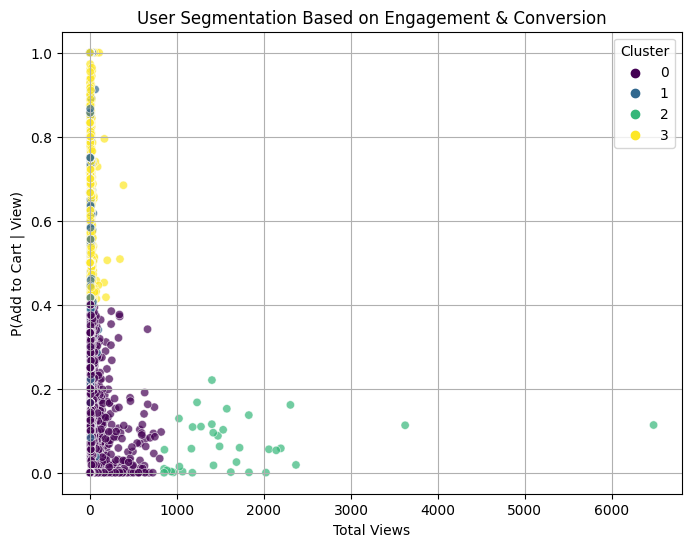

/opt/conda/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


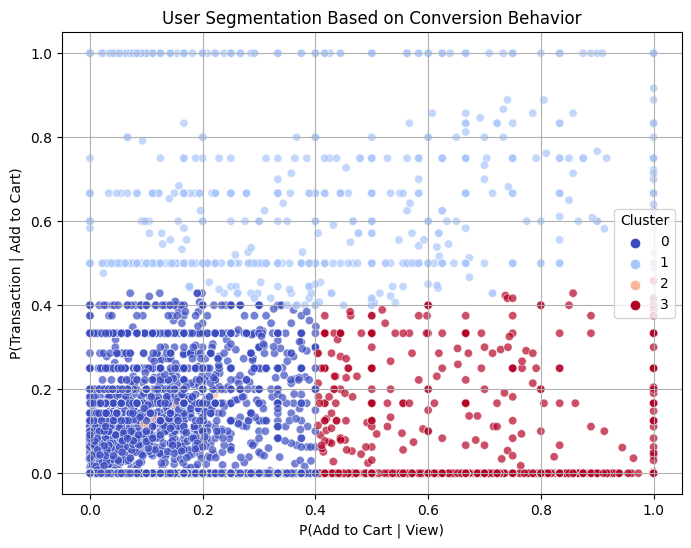


Cluster Summary:
           total_view  p_addtocart_given_view  p_transaction_given_addtocart
cluster                                                                    
0           1.843627                0.001862                       0.000601
1           3.071231                0.526341                       0.837017
2        1658.714286                0.066158                       0.070640
3           1.988255                0.811102                       0.005179


In [17]:


df = users.copy()

# Select relevant features for clustering
features = ['total_view', 'p_addtocart_given_view', 'p_transaction_given_addtocart']
df_cluster = df[features].dropna()  # Drop NaN values to avoid errors

# Standardize the data (important for K-Means)
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_cluster)

# Find Optimal Number of Clusters using Elbow Method
inertia = []
K_range = range(1, 11)  # Checking for 1 to 10 clusters

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(df_scaled)
    inertia.append(kmeans.inertia_)

# Plot the Elbow Curve
plt.figure(figsize=(8, 5))
plt.plot(K_range, inertia, marker='o', linestyle='-', color='blue')
plt.xlabel("Number of Clusters")
plt.ylabel("Inertia (Within-Cluster Sum of Squares)")
plt.title("Elbow Method for Optimal K")
plt.grid(True)
plt.show()

# Apply K-Means Clustering 
optimal_k = 4  # Choose the best K based on the elbow curve
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
df_cluster['cluster'] = kmeans.fit_predict(df_scaled)

#Visualizing the Clusters 
plt.figure(figsize=(8, 6))
sns.scatterplot(x=df_cluster['total_view'], y=df_cluster['p_addtocart_given_view'], hue=df_cluster['cluster'], palette="viridis", alpha=0.7)
plt.xlabel("Total Views")
plt.ylabel("P(Add to Cart | View)")
plt.title("User Segmentation Based on Engagement & Conversion")
plt.legend(title="Cluster")
plt.grid(True)
plt.show()

plt.figure(figsize=(8, 6))
sns.scatterplot(x=df_cluster['p_addtocart_given_view'], y=df_cluster['p_transaction_given_addtocart'], hue=df_cluster['cluster'], palette="coolwarm", alpha=0.7)
plt.xlabel("P(Add to Cart | View)")
plt.ylabel("P(Transaction | Add to Cart)")
plt.title("User Segmentation Based on Conversion Behavior")
plt.legend(title="Cluster")
plt.grid(True)
plt.show()

# Cluster Summary
cluster_summary = df_cluster.groupby("cluster").mean()
print("\nCluster Summary:\n", cluster_summary)
